RESULT of this experiment
USE AREA intepolation for shrinking and use LANCZOs4/CUBIC interpolation for expanding

I want to check the conversion of small size vs the averages of 4x4. Which has better psnr to the orignal image. Also I want to the the increase of image size by 4 times. Which gives better result.

In [16]:
from matplotlib import pyplot as plt
from PIL import Image
import numpy as np
import pandas as pd
import time
import cv2
from os import walk

In [17]:
openmode=cv2.IMREAD_COLOR
dir_path='./samples/'
output_path='./test_size_results/'

In [18]:
files = []
for (dir_path, dir_names, file_names) in walk(dir_path):
    files.extend([dir_path+"/"+f for f in file_names])
files

['./samples//cat3.jpg',
 './samples//lena_color.gif',
 './samples//lena.gif',
 './samples//cat2.jpg',
 './samples//art.png',
 './samples/textures/1.2.12(1).tiff',
 './samples/textures/1.2.13(1).tiff',
 './samples/textures/1.4.01.tiff',
 './samples/textures/1.5.07.tiff',
 './samples/textures/1.3.04.tiff',
 './samples/textures/1.4.10.tiff',
 './samples/textures/texmos1.p512.tiff',
 './samples/textures/texmos2.p512.tiff',
 './samples/textures/1.5.03(1).tiff',
 './samples/textures/1.5.03(2).tiff',
 './samples/textures/1.2.11.tiff',
 './samples/textures/1.4.08.tiff',
 './samples/textures/1.3.06.tiff',
 './samples/textures/1.2.03.tiff',
 './samples/textures/1.3.13.tiff',
 './samples/textures/1.5.04.tiff',
 './samples/textures/1.2.09.tiff',
 './samples/textures/1.2.05.tiff',
 './samples/textures/1.1.07.tiff',
 './samples/textures/1.2.02.tiff',
 './samples/textures/texmos2.s512.tiff',
 './samples/textures/1.2.11(1).tiff',
 './samples/textures/1.3.11.tiff',
 './samples/textures/1.1.01.tiff',
 '

In [19]:
len(files)

169

making dataframe

In [20]:
CV2INTERS=[cv2.INTER_AREA,
# cv2.INTER_BITS,
# cv2.INTER_BITS2,
# cv2.INTER_CUBIC,
# cv2.INTER_LANCZOS4,
# cv2.INTER_LINEAR,
# cv2.INTER_LINEAR_EXACT,
# cv2.INTER_NEAREST
]
CV2INTERL=[
  # cv2.INTER_AREA,
# cv2.INTER_BITS,
# cv2.INTER_BITS2,
cv2.INTER_CUBIC,
cv2.INTER_LANCZOS4,
# cv2.INTER_LINEAR,
# cv2.INTER_LINEAR_EXACT,
# cv2.INTER_NEAREST
]
CV2INTER_STRS=['AREA',
              # 'BITS', 'BITS2', 
              # 'CUBIC', 'LANCZOS4',
              # 'LINEAR', 'LINEAR_EXACT', 'NEAREST'
              ]
CV2INTER_STRL=[
  # 'AREA',
              # 'BITS', 'BITS2', 
              'CUBIC', 'LANCZOS4',
              # 'LINEAR', 'LINEAR_EXACT', 'NEAREST'
              ]

In [21]:
columns=['file','size','small_method','small_t','small_size','large_method','large_t', 'psnr']

In [22]:
df=pd.DataFrame(columns=columns)

In [23]:
zoomx=16
shrink=1/zoomx
enlarge=zoomx

testing on one image

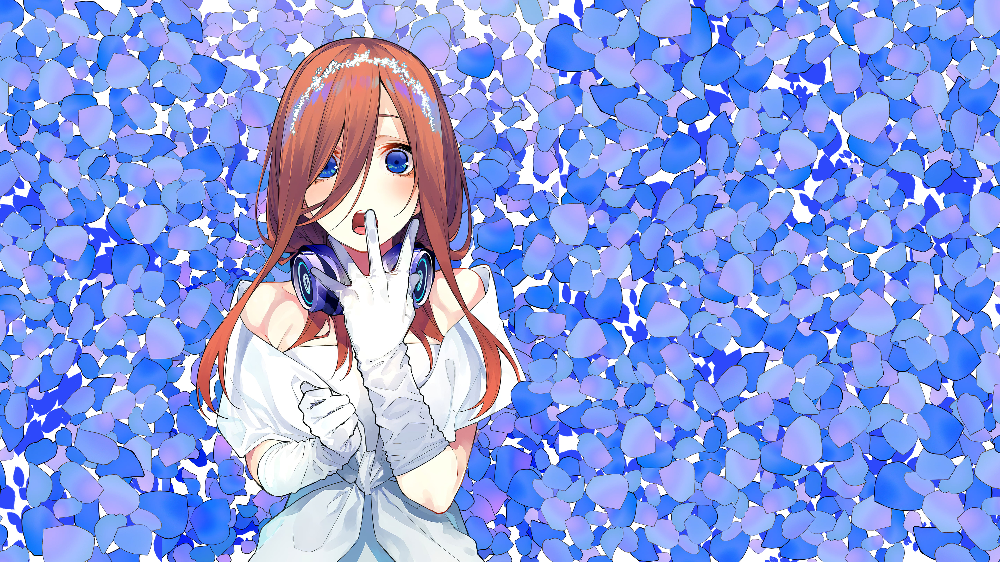

In [24]:
imarr=cv2.imread('./samples//large/miku.jpg', openmode)
Image.fromarray(imarr[:,:,::-1])

In [25]:
imarrsmall=cv2.resize(imarr, None, fx=shrink, fy=shrink, interpolation=cv2.INTER_AREA)


In [26]:
cv2.imwrite(output_path+'miku_small.jpg', imarrsmall)

True

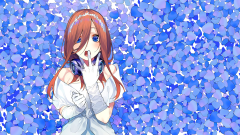

In [27]:
Image.fromarray(imarrsmall[:,:,::-1])

In [28]:
imarrlarge=cv2.resize(imarrsmall, None, fx=enlarge, fy=enlarge, interpolation=cv2.INTER_CUBIC)


In [29]:
cv2.imwrite(output_path+'miku_large_cubic.jpg', imarrlarge)

True

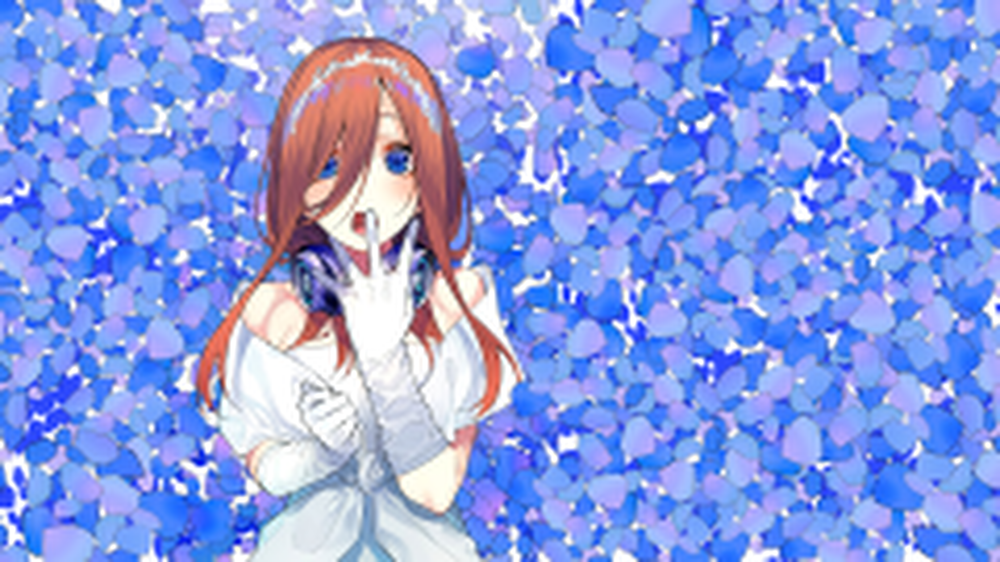

In [15]:
Image.fromarray(imarrlarge[:,:,::-1])

In [27]:
for f in files:
  imarr=cv2.imread(f, openmode)
  if imarr is None or imarr.shape[0]%4!=0 or  imarr.shape[1]%4!=0 :
    print("Skipping:",f)
    continue
  for idxs, sm in enumerate(CV2INTERS):
    small_t=time.time()
    imarrsmall=cv2.resize(imarr, None, fx=shrink, fy=shrink, interpolation=sm)
    small_t=time.time()-small_t
    for idxl, lm in enumerate(CV2INTERL):
      large_t=time.time()
      imarrlarge=cv2.resize(imarrsmall, None, fx=enlarge, fy=enlarge, interpolation=lm)
      large_t=time.time()-large_t
      # add to the data frame
      df.loc[len(df)]=[f,imarr.shape,CV2INTER_STRS[idxs],small_t ,imarrsmall.shape,CV2INTER_STRL[idxl],large_t,cv2.PSNR(imarr,imarrlarge)]
    # save after every small method
    df.to_csv(output_path+'test_size_rgb_specific.csv', index=False)
      

Skipping: ./samples//lena_color.gif
Skipping: ./samples//lena.gif
Skipping: ./samples/misc/lena_gray.gif
Skipping: ./samples/aerials/wash-ir.tiff


ab har kisi ka maximum and 2nd maximum nika lain gy

In [28]:
dfmax=pd.DataFrame(columns=columns)

In [29]:
df

,file,size,small_method,small_t,small_size,large_method,large_t,psnr
0,./samples//cat3.jpg,"(320, 512, 3)",AREA,0.000275,"(20, 32, 3)",CUBIC,0.002144,28.260026
1,./samples//cat3.jpg,"(320, 512, 3)",AREA,0.000275,"(20, 32, 3)",LANCZOS4,0.002897,28.360047
2,./samples//cat2.jpg,"(960, 640, 3)",AREA,0.001090,"(60, 40, 3)",CUBIC,0.003540,32.493320
3,./samples//cat2.jpg,"(960, 640, 3)",AREA,0.001090,"(60, 40, 3)",LANCZOS4,0.010617,32.574205
4,./samples//art.png,"(704, 448, 3)",AREA,0.000488,"(44, 28, 3)",CUBIC,0.002162,16.148434
...,...,...,...,...,...,...,...,...
325,./samples/aerials/2.2.19.tiff,"(1024, 1024, 3)",AREA,0.001517,"(64, 64, 3)",LANCZOS4,0.012916,26.225742
326,./samples/aerials/2.2.13.tiff,"(1024, 1024, 3)",AREA,0.001645,"(64, 64, 3)",CUBIC,0.003567,24.991552
327,./samples/aerials/2.2.13.tiff,"(1024, 1024, 3)",AREA,0.001645,"(64, 64, 3)",LANCZOS4,0.011620,25.007709
328,./samples/aerials/2.1.07.tiff,"(512, 512, 3)",AREA,0.000389,"(32, 32, 3)",CUBIC,0.001758,25.176070


In [30]:
# take out the maximum and 2nd maximum psnr methods for each files
for f in files:
  print(f)
  temp=df[df['file']==f]
  if len(temp)==0:
    continue
  klargest=temp['psnr'].nlargest(2)
  dfmax=pd.concat([dfmax,temp[temp['psnr']==klargest.iloc[0]]])
  # pd.concat([dfmax,temp[temp['psnr']==klargest.iloc[1]]])
  

./samples//cat3.jpg
./samples//lena_color.gif
./samples//lena.gif
./samples//cat2.jpg
./samples//art.png
./samples/textures/1.2.12(1).tiff
./samples/textures/1.2.13(1).tiff
./samples/textures/1.4.01.tiff
./samples/textures/1.5.07.tiff
./samples/textures/1.3.04.tiff
./samples/textures/1.4.10.tiff
./samples/textures/texmos1.p512.tiff
./samples/textures/texmos2.p512.tiff
./samples/textures/1.5.03(1).tiff
./samples/textures/1.5.03(2).tiff
./samples/textures/1.2.11.tiff
./samples/textures/1.4.08.tiff
./samples/textures/1.3.06.tiff
./samples/textures/1.2.03.tiff
./samples/textures/1.3.13.tiff
./samples/textures/1.5.04.tiff
./samples/textures/1.2.09.tiff
./samples/textures/1.2.05.tiff
./samples/textures/1.1.07.tiff
./samples/textures/1.2.02.tiff
./samples/textures/texmos2.s512.tiff
./samples/textures/1.2.11(1).tiff
./samples/textures/1.3.11.tiff
./samples/textures/1.1.01.tiff
./samples/textures/1.5.06.tiff
./samples/textures/1.5.04(2).tiff
./samples/textures/1.1.08.tiff
./samples/textures/1.1

In [31]:
dfmax

,file,size,small_method,small_t,small_size,large_method,large_t,psnr
1,./samples//cat3.jpg,"(320, 512, 3)",AREA,0.000275,"(20, 32, 3)",LANCZOS4,0.002897,28.360047
3,./samples//cat2.jpg,"(960, 640, 3)",AREA,0.00109,"(60, 40, 3)",LANCZOS4,0.010617,32.574205
5,./samples//art.png,"(704, 448, 3)",AREA,0.000488,"(44, 28, 3)",LANCZOS4,0.007186,16.184895
6,./samples/textures/1.2.12(1).tiff,"(512, 512, 3)",AREA,0.000384,"(32, 32, 3)",CUBIC,0.002,12.376764
9,./samples/textures/1.2.13(1).tiff,"(512, 512, 3)",AREA,0.000404,"(32, 32, 3)",LANCZOS4,0.006925,12.486528
...,...,...,...,...,...,...,...,...
321,./samples/aerials/2.2.23.tiff,"(1024, 1024, 3)",AREA,0.001828,"(64, 64, 3)",LANCZOS4,0.011877,29.694399
323,./samples/aerials/2.2.11.tiff,"(1024, 1024, 3)",AREA,0.001493,"(64, 64, 3)",LANCZOS4,0.011933,24.948455
325,./samples/aerials/2.2.19.tiff,"(1024, 1024, 3)",AREA,0.001517,"(64, 64, 3)",LANCZOS4,0.012916,26.225742
327,./samples/aerials/2.2.13.tiff,"(1024, 1024, 3)",AREA,0.001645,"(64, 64, 3)",LANCZOS4,0.01162,25.007709


In [32]:
len(dfmax)

165

In [33]:
dfmax.groupby(['small_method','large_method']).count()


file  size  small_t  small_size  large_t  psnr
small_method large_method                                                
AREA         CUBIC           72    72       72          72       72    72
             LANCZOS4        93    93       93          93       93    93

In [34]:
dfmax.to_csv(output_path+'test_size_rgb_specific_max.csv', index=False)

In [35]:
dfmax=pd.DataFrame(columns=columns)

In [36]:
# take out the maximum and 2nd maximum psnr methods for each files
for f in files:
  # print(f)
  temp=df[df['file']==f]
  if len(temp)==0:
    continue
  klargest=temp['psnr'].nlargest(2)
  dfmax=pd.concat([dfmax,temp[temp['psnr']==klargest.iloc[1]]])
  # pd.concat([dfmax,temp[temp['psnr']==klargest.iloc[1]]])
  

./samples//cat3.jpg
./samples//lena_color.gif
./samples//lena.gif
./samples//cat2.jpg
./samples//art.png
./samples/textures/1.2.12(1).tiff
./samples/textures/1.2.13(1).tiff
./samples/textures/1.4.01.tiff
./samples/textures/1.5.07.tiff
./samples/textures/1.3.04.tiff
./samples/textures/1.4.10.tiff
./samples/textures/texmos1.p512.tiff
./samples/textures/texmos2.p512.tiff
./samples/textures/1.5.03(1).tiff
./samples/textures/1.5.03(2).tiff
./samples/textures/1.2.11.tiff
./samples/textures/1.4.08.tiff
./samples/textures/1.3.06.tiff
./samples/textures/1.2.03.tiff
./samples/textures/1.3.13.tiff
./samples/textures/1.5.04.tiff
./samples/textures/1.2.09.tiff
./samples/textures/1.2.05.tiff
./samples/textures/1.1.07.tiff
./samples/textures/1.2.02.tiff
./samples/textures/texmos2.s512.tiff
./samples/textures/1.2.11(1).tiff
./samples/textures/1.3.11.tiff
./samples/textures/1.1.01.tiff
./samples/textures/1.5.06.tiff
./samples/textures/1.5.04(2).tiff
./samples/textures/1.1.08.tiff
./samples/textures/1.1

In [37]:
len(dfmax)

165

In [38]:
dfmax.groupby(['small_method','large_method']).count()


file  size  small_t  small_size  large_t  psnr
small_method large_method                                                
AREA         CUBIC           93    93       93          93       93    93
             LANCZOS4        72    72       72          72       72    72

In [39]:
dfmax.to_csv(output_path+'test_size_rgb_specific_2ndmax.csv', index=False)

In [40]:
dfmax=pd.DataFrame(columns=columns)

In [41]:
# take out the maximum and 2nd maximum psnr methods for each files
for f in files:
  print(f)
  temp=df[df['file']==f]
  if len(temp)==0:
    continue
  klargest=temp['psnr'].nlargest(2)
  dfmax=pd.concat([dfmax,temp[temp['psnr']==klargest.iloc[0]]])
  dfmax=pd.concat([dfmax,temp[temp['psnr']==klargest.iloc[1]]])
  

./samples//cat3.jpg
./samples//lena_color.gif
./samples//lena.gif
./samples//cat2.jpg
./samples//art.png
./samples/textures/1.2.12(1).tiff
./samples/textures/1.2.13(1).tiff
./samples/textures/1.4.01.tiff
./samples/textures/1.5.07.tiff
./samples/textures/1.3.04.tiff
./samples/textures/1.4.10.tiff
./samples/textures/texmos1.p512.tiff
./samples/textures/texmos2.p512.tiff
./samples/textures/1.5.03(1).tiff
./samples/textures/1.5.03(2).tiff
./samples/textures/1.2.11.tiff
./samples/textures/1.4.08.tiff
./samples/textures/1.3.06.tiff
./samples/textures/1.2.03.tiff
./samples/textures/1.3.13.tiff
./samples/textures/1.5.04.tiff
./samples/textures/1.2.09.tiff
./samples/textures/1.2.05.tiff
./samples/textures/1.1.07.tiff
./samples/textures/1.2.02.tiff
./samples/textures/texmos2.s512.tiff
./samples/textures/1.2.11(1).tiff
./samples/textures/1.3.11.tiff
./samples/textures/1.1.01.tiff
./samples/textures/1.5.06.tiff
./samples/textures/1.5.04(2).tiff
./samples/textures/1.1.08.tiff
./samples/textures/1.1

In [42]:
len(dfmax)

330

In [43]:
dfmax.groupby(['small_method','large_method']).count()

file  size  small_t  small_size  large_t  psnr
small_method large_method                                                
AREA         CUBIC          165   165      165         165      165   165
             LANCZOS4       165   165      165         165      165   165

In [44]:
# dfmax.groupby(['small_method','large_method']).count().to_csv(output_path+'test_size_rgb_count.csv', index=False)